In [1]:
from utils import *
import librosa
import librosa.display
from IPython.display import Audio
song_name = "Heat Waves" #"In My Blood"

In [2]:
data, samplerate = librosa.load(f"{song_name}.wav")
length = data.shape[0] / samplerate
y_harmonic, y_percussive = librosa.effects.hpss(data)
tempo, beats = track_beats(y_percussive,samplerate,plot=False)

In [3]:
Audio(y_percussive,rate=samplerate)

In [4]:
Audio(y_harmonic,rate=samplerate)

In [5]:
S_data = melspect(data, samplerate, plot=False)
S_harmonic = melspect(y_harmonic, samplerate, title="harmonic mel spectrogram", plot=False)
S_percussive = melspect(y_percussive, samplerate, title="precussive mel spectrogram", plot=False)

In [6]:
C_harmonic = chromagram(y_harmonic, samplerate, title="harmonic chromagram", plot=False)
C_data = chromagram(data, samplerate, title="data chromagram", plot=False)
C_percussive = chromagram(y_percussive, samplerate, title="precussive chromagram", plot=False)

In [7]:
M_data = MFCC(S_data, samplerate, plot=False)
M_harmonic = MFCC(S_harmonic, samplerate, plot=False)
M_percussive = MFCC(S_percussive, samplerate, plot=False)

In [8]:
M_sync_data = mel_sync(M_data, beats)

In [9]:
#onsers and beat tracker todop
onset_envelope = librosa.onset.onset_strength(y=data) / 7
onsets_time = librosa.onset.onset_detect(y=data, onset_envelope=onset_envelope, units='time')
onsets_i = librosa.onset.onset_detect(y=data, onset_envelope=onset_envelope)

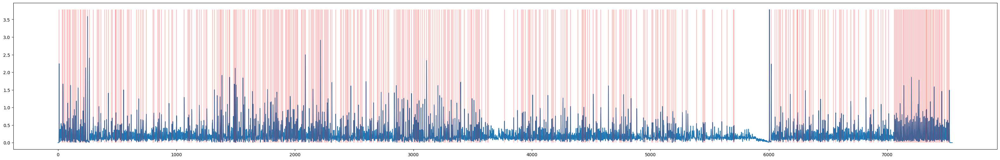

In [10]:
plt.figure(figsize=(40, 6))
plt.plot(onset_envelope)
plt.vlines(onsets_i, 0, onset_envelope.max(),"red", alpha=0.25,)

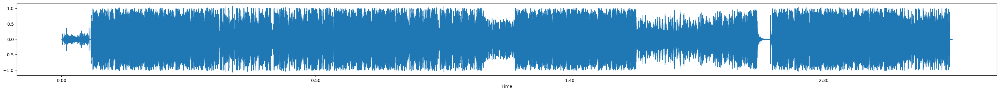

In [20]:
plt.figure(figsize=(40, 3))
# help(librosa.display.waveplot)
# librosa.display.waveplot(data,)
librosa.display.waveshow(data,)

In [ ]:
rmse = RMSE(data)

In [ ]:
C_sync_harmonic = beat_sync_chroma(C_harmonic, beats, samplerate, plot=False)
C_sync_percussive = beat_sync_chroma(C_percussive, beats, samplerate, plot=False)
C_sync_data = beat_sync_chroma(C_data, beats, samplerate, plot=False)

In [ ]:
ahap = AHAP()

In [ ]:
# continuous if for bass/energy
frames = range(len(energy))
t = librosa.frames_to_time(frames, sr=samplerate, hop_length=hop_length)
rmse = rmse/rmse.max() * 1.4
for i in range(len(rmse)):
    ahap.add_haptic_continuous_event(float(t[i]),float(length/(len(t))), float(rmse[i]),float(rmse[i]))


In [ ]:
## transient is for notes + beats
for indx, i in enumerate(onsets_i):
    ahap.add_haptic_transient_event(float(onsets_time[indx]),float(onset_envelope[i]),float(onset_envelope[i]))
for i in beats:
    ahap.add_haptic_transient_event(float(i), 0.4, 0.7)

In [ ]:
ahap.export(f'{song_name}.ahap','')